In [1]:
import math
import numpy as np
from gymnasium.utils import seeding
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="darkgrid")
import cv2
import random

CHECKPOINTS = 12
SCALE       = 6.0
TRACK_RAD   = 900/SCALE
TRACK_TURN_RATE = 0.31
TRACK_DETAIL_STEP = 21/SCALE
PLAYFIELD   = 2000/SCALE # Game over boundary

IMG_SIZE = 32  # Pixels

np_random, seed = seeding.np_random(7)

pygame 2.5.1 (SDL 2.28.2, Python 3.8.10)
Hello from the pygame community. https://www.pygame.org/contribute.html


In [2]:
from gym_multi_car_racing import bezier

def get_track(control_points=None, mindst=0.08, np_random=np_random):
    if control_points is not None:
        a = np.array(control_points)
        x, y, _ = bezier.get_bezier_curve(a=a, rad=0.2, edgy=0.2, numpoints=40)
    else:
        a = bezier.get_random_points(n=12, scale=PLAYFIELD, mindst=mindst, np_random=np_random) // 30 * 30
        x, y, _ = bezier.get_bezier_curve(a=a, rad=0.2, edgy=0.2, numpoints=40)

    x, y = np.clip(0, x.max(), x), np.clip(0, y.max(), y)

    return a, x, y

In [3]:
def plot_track(track, checkpoints=None):
    # Plot track
    plt.plot(track[:,1], track[:,0], linewidth=9, color=[0.4, 0.4, 0.4])

    # Plot checkpoints
    if checkpoints is not None:
        for i in range(len(checkpoints)):
            y, x = checkpoints[i,:]
            plt.plot(x, y, 'o', markersize=2, color="tab:orange")
            plt.text(x, y, str(i), fontsize=10, color="black")
    
    plt.xlim(-20,360)
    plt.ylim(-20,360)

    ax = plt.gca()
    ax.set_facecolor(np.array([102, 230, 102])/255.)

In [4]:
def get_image(coordinates, img_size=(32,32)):
    max_value = 330 if coordinates.max() < 330 else coordinates.max()

    if coordinates[:,0].min() < 0:
        coordinates[:,0] = coordinates[:,0] - coordinates[:,0].min()
    if coordinates[:,1].min() < 0:
        coordinates[:,1] = coordinates[:,1] - coordinates[:,1].min()
    coordinates = coordinates // (max_value/(img_size[0]-1))
    coordinates = coordinates.astype(np.int32)

    # Clip to 0-31
    coordinates = np.clip(coordinates, 0, img_size[0]-1)
    
    img = np.zeros(img_size)

    for i in range(coordinates.shape[0]):
        img[coordinates[i,1], coordinates[i,0]] = 1

    return img

from PIL import Image, ImageDraw
import numpy as np

def get_image_(points, img_size=(32, 32), fill=False):
    """
    Create a 2D image of a curve using a set of points.

    Parameters:
    - points: List of tuples representing (x, y) coordinates of the curve.
    - img_size: Tuple representing the size of the image (width, height).

    Returns:
    - img_array: NumPy array representing the image.

    Example:
    >>> points = [(0, 0), (1, 1), (2, 4), (3, 9), (4, 16)]
    >>> image_array = get_image(points)
    """
    # Find the bounding box of the points
    min_x, min_y = np.min(points, axis=0)
    max_x, max_y = np.max(points, axis=0)

    # Create a blank image with a black background
    width = int(max_x - min_x) + 20
    height = int(max_y - min_y) + 20
    image = Image.new("RGB", (width, height), "black")
    draw = ImageDraw.Draw(image)

    # Translate points to the image coordinates
    translated_points = [(x - min_x + 10, y - min_y + 10) for x, y in points]

    # Draw image
    if fill:
        # Fill inside the curve
        draw.polygon(translated_points, fill="white")
    else:
        # Draw the curve on the image
        draw.line(translated_points, fill="white", width=2)

    # Convert the PIL image to a NumPy array
    img_array = np.array(image)

    # Convert to grayscale
    img_array = np.mean(img_array, axis=2)

    # Resize image
    width, height = img_size
    img_array = cv2.resize(img_array, dsize=(width, height), interpolation=cv2.INTER_AREA)

    # Normalize pixel values
    img_array = img_array / img_array.max()

    return img_array

Generate random tracks

In [21]:
from complexity import complexity

In [53]:
NUM_TRACKS = 100_000
IMG_SIZE = (64,64)

X = []  # Track control points
Y = []  # Track low resolution image
complexities = []

for i in range(NUM_TRACKS):
    print(f"Generating track {i+1}/{NUM_TRACKS}", end="\r")
    # Generate random track
    checkpoints, x, y = get_track(np_random=np_random)
    X.append(checkpoints)
    # Get image from track
    track = np.array([x, y]).T
    Y.append(get_image_(track, img_size=IMG_SIZE, fill=True))

    # Get track complexity
    p = np.array(list(zip(x, y)))
    complexities.append([complexity(p)['area'],
                         complexity(p)['perimeter'],
                         complexity(p)['amplitude'],
                         complexity(p)['convex'],
                         complexity(p)['notches'],
                         complexity(p)['complexity']])

X = np.array(X).astype(np.float32) // 30  # Scale down to 0-11
Y = np.array(Y).astype(np.float32)
Y = np.ceil(Y)  # Binarize

complexities = np.array(complexities) / np.max(complexities) * 10
complexities = np.round(complexities, 0).astype(np.int32)

X.shape, Y.shape

((100000, 12, 2), (100000, 64, 64))

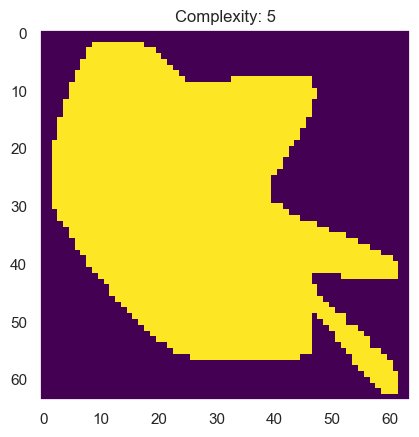

In [61]:
idx = random.randint(0, NUM_TRACKS-1)

plt.imshow(np.ceil(Y[idx]), cmap="viridis")
plt.title(f"Complexity: {complexities[idx]}")
plt.grid(False)

In [66]:
# Save data
np.save("tracks_64x64_images.npy", Y.astype(np.int16))
np.save("tracks_64x64_complexities.npy", complexities)

Text(0.5, 1.0, 'Distribution of track complexities')

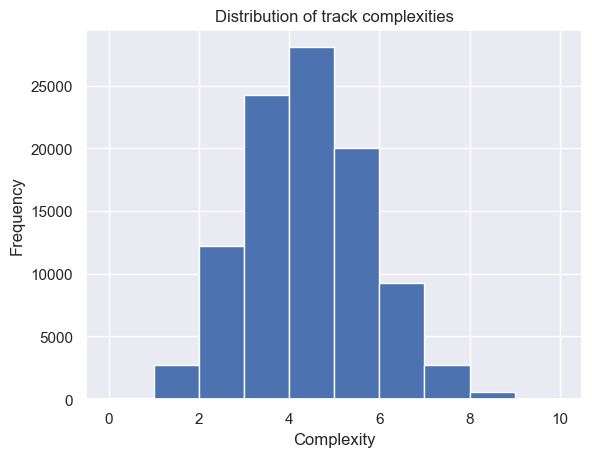

In [59]:
# Plot distribution of complexities
plt.figure()
plt.hist(complexities, bins=10)
plt.xlabel("Complexity")
plt.ylabel("Frequency")
plt.title("Distribution of track complexities")

Load track images

In [64]:
X = np.load('tracks_64x64_images.npy').astype(np.float32)  # Track images
# Y = np.load('tracks_64x64_complexities.npy')
Y = np.zeros_like(X)
X.shape, Y.shape

((100000, 64, 64), (100000, 64, 64))

Create dataset

In [65]:
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF

class TracksDataset(Dataset):
    """Face Landmarks dataset."""

    def __init__(self, tracks, checkpoints=None):
        self.tracks = tracks
        self.checkpoints = checkpoints

    def __len__(self):
        return len(self.tracks)

    def __getitem__(self, index):
        x = TF.to_tensor(self.tracks[index])
        if self.checkpoints is not None:
            y = TF.to_tensor(self.checkpoints[index])
        else:
            y = None
        return x, y

In [66]:
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms.functional as TF

class ImagesDataset(Dataset):
    """Face Landmarks dataset."""

    def __init__(self, imgs, labels):
        self.imgs = imgs
        self.labels = labels

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, index):
        x = TF.to_tensor(self.imgs[index])
        y = torch.tensor(self.labels[index])

        return x, y

## GAN
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [67]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


Weight initialization

In [68]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        if m.weight is not None:
            nn.init.normal_(m.weight.data, 1.0, 0.02)
            nn.init.constant_(m.bias.data, 0)

In [69]:
# Batch size during training
batch_size = 16

# Number of channels in the training images
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10  # Train for more epochs (50, 100)

# Learning rate for optimizers
lr = 1e-4

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [70]:
# Create training and validation sets
from sklearn.model_selection import train_test_split

X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.1, random_state=42)

# Create datasets
train_dataset = TracksDataset(np.expand_dims(X_train, axis=-1), np.expand_dims(Y_train, axis=-1))
val_dataset = TracksDataset(np.expand_dims(X_val, axis=-1), np.expand_dims(Y_val, axis=-1))

# Data loader
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

Generator

In [71]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [72]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


Discriminator

In [73]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Add Gaussian noise to the input
            #nn.BatchNorm2d(nc, affine=False),
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        # Add Gaussian noise
        noise = torch.randn_like(input)
        input = input + noise
        return self.main(input)


In [74]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [75]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Training

In [77]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(train_loader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[1].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/10][0/5625]	Loss_D: 1.7322	Loss_G: 0.7570	D(x): 0.4848	D(G(z)): 0.5234 / 0.5055
[0/10][50/5625]	Loss_D: 1.9125	Loss_G: 0.9006	D(x): 0.4656	D(G(z)): 0.5470 / 0.4580
[0/10][100/5625]	Loss_D: 2.0473	Loss_G: 0.8633	D(x): 0.3658	D(G(z)): 0.4744 / 0.5152
[0/10][150/5625]	Loss_D: 2.0084	Loss_G: 0.6270	D(x): 0.3466	D(G(z)): 0.4795 / 0.5794
[0/10][200/5625]	Loss_D: 2.0072	Loss_G: 0.7699	D(x): 0.5922	D(G(z)): 0.5961 / 0.5408
[0/10][250/5625]	Loss_D: 2.0755	Loss_G: 0.6681	D(x): 0.4211	D(G(z)): 0.5479 / 0.5648
[0/10][300/5625]	Loss_D: 2.3521	Loss_G: 0.6007	D(x): 0.3514	D(G(z)): 0.6398 / 0.5828
[0/10][350/5625]	Loss_D: 2.2986	Loss_G: 0.8860	D(x): 0.4249	D(G(z)): 0.6616 / 0.4746
[0/10][400/5625]	Loss_D: 2.3121	Loss_G: 0.8825	D(x): 0.3504	D(G(z)): 0.5966 / 0.4864
[0/10][450/5625]	Loss_D: 1.9515	Loss_G: 0.8557	D(x): 0.4281	D(G(z)): 0.5538 / 0.4982
[0/10][500/5625]	Loss_D: 1.8747	Loss_G: 0.9087	D(x): 0.4032	D(G(z)): 0.5562 / 0.4577
[0/10][550/5625]	Loss_D: 2.3829	Loss_G: 0.

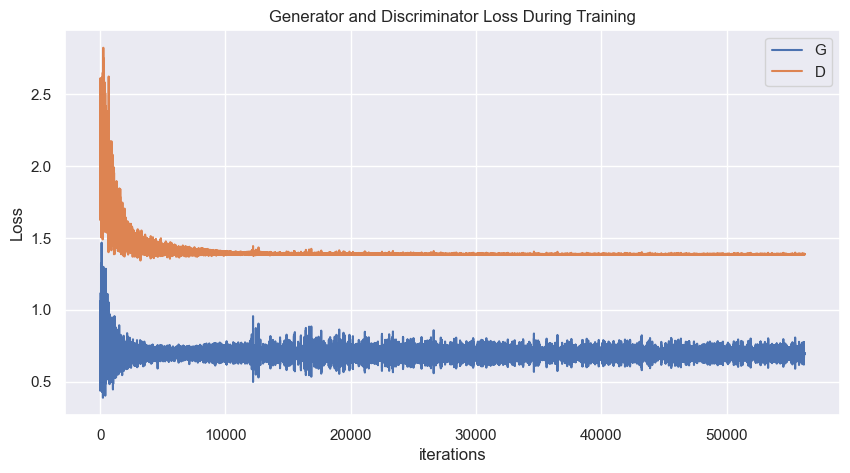

In [78]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [79]:
# Save GAN
torch.save(netG.state_dict(), "generator.pth")
torch.save(netD.state_dict(), "discriminator.pth")

In [ ]:
# Load GAN


In [80]:
# Create new color map
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

grass_green = np.array([102/255, 230/255, 102/255, 1])
road_gray = np.array([0.4, 0.4, 0.4, 1])
light_gray = np.array([0.5, 0.5, 0.5, 1])
#newcolors = np.array([grass_green, light_gray, road_gray])
# Interpolate between grass_green and road_gray
N = 4
newcolors = np.ones((N, 4))
newcolors[:, 0] = np.linspace(grass_green[0], road_gray[0], N)
newcolors[:, 1] = np.linspace(grass_green[1], road_gray[1], N)
newcolors[:, 2] = np.linspace(grass_green[2], road_gray[2], N)
newcolors[:, 3] = np.linspace(grass_green[3], road_gray[3], N)
new_cmp = ListedColormap(newcolors)

Animation size has reached 21228897 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


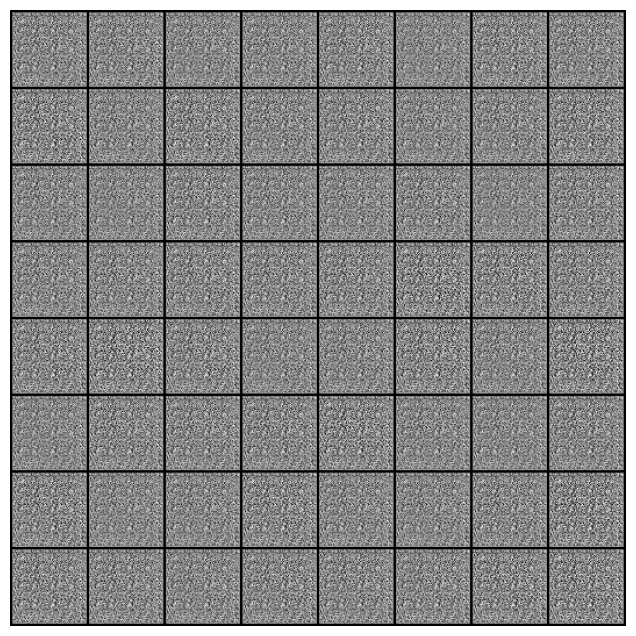

In [81]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), cmap=new_cmp, animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

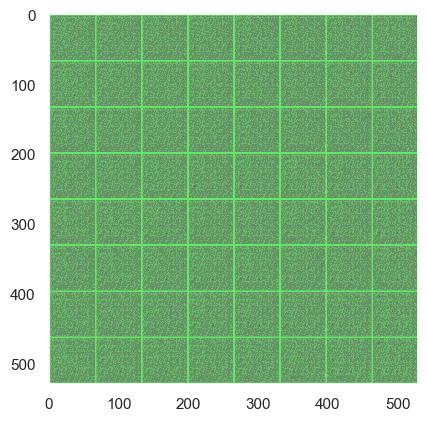

In [83]:
plt.imshow(img_list[-1].cpu().numpy().mean(axis=0), cmap=new_cmp)
plt.grid(False)